# Marks Molecule Calculations Code

# Startup

## Imports

In [51]:
import numpy as np
np.set_printoptions(precision=3,suppress=True,linewidth=100000, edgeitems=10000)
from sympy.physics.quantum.cg import CG
import pandas as pd
import math
import scipy.linalg
import IPython.display
import matplotlib.pyplot as plt
import MarksConstants as mc
import Miscellaneous as misc
import matplotlib.style
import matplotlib as mpl
import copy
matplotlib.style.use('default')
pd.set_option("max_colwidth", 200)
from importlib import reload

The important import!

In [25]:
import MoleculeCalculation as mol

## Constants

In [26]:
E_HFS_5S12_F1F2 = (mc.Rb87_Ground_ToF2-mc.Rb87_Ground_ToF1)/2
E_HFS_5P12_F1F2 = (mc.Rb87_5P12_ToF2-mc.Rb87_5P12_ToF1)/2
E_FS_5P12_5P32 = mc.h*(mc.Rb87_D2LineFrequency-mc.Rb87_D1LineFrequency)# / mc.h

transFreq = 2*np.pi*(mc.Rb87_D2LineFrequency+mc.Rb87_D1LineFrequency)/2
lifetime = (mc.Rb87_D1_Lifetime+mc.Rb87_D2_Lifetime)/2
C_3_val_alt = 3*mc.hbar*mc.c**3/(4*lifetime*transFreq**3)# * 1e27 / mc.h

C_3_val = mc.Rb87_C3
print(E_FS_5P12_5P32, C_3_val)
print("From first principles one can calculate C3 to be: ", C_3_val_alt, "but this differs from the literature value which is: ", C_3_val)

4.7197635548748796e-21 5.94492796981645e-48
From first principles one can calculate C3 to be:  5.774794407751793e-48 but this differs from the literature value which is:  5.94492796981645e-48


A = 2/V**(3/2)

# Calculations

## Create the relevant bases

### Create Atomic Bases

these are the ordinary single-atom bases that you'd use to describe your atom if you didn't know anything about the molecular symmetries.

In [27]:
lsiBasis, jiBasis, fBasis, lsiBasis2Atom, jiBasis2Atom, fBasis2Atom = mol.createAtomicBases([0,1], [1/2], [3/2])
lsiToJi_Op = mol.create_lsiToJi_Op(lsiBasis,jiBasis)
jiToF_Op = mol.create_jiToF_Op(jiBasis, fBasis)
caseAMostlySymHfs = mol.createCaseABasis_MostlySym([1],[0,1], [3/2], I_BOvals=['g', 'u'])
caseASymHfs = mol.createCaseABasis_Sym([1],[0,1],[3/2], I_BOvals=['g','u'])

In [55]:
expandedBOBasis = mol.addFsRelevantStates(mol.boStates)
caseASymHfs = mol.addHfsRelevantStates(expandedBOBasis)

note that as the two particle bases are kronicker-products of the one-particle basis, they include doubly-excited atoms with $L_a = L_b = 1$

In [56]:
structureList = [lsiBasis, jiBasis, fBasis, lsiBasis2Atom, jiBasis2Atom, fBasis2Atom, caseAMostlySymHfs, caseASymHfs, lsiToJi_Op, jiToF_Op]

basisDesc = pd.DataFrame()
basisDesc["Size"] = [np.array(base).shape for base in structureList]
basisDesc["Keys"] = [str([r"$"+key + "$" for key in base[0].keys()]) for base in structureList[:-2]] + ["N/A", "N/A"]
basisDesc["Example Value"] = [base[0] for base in structureList]
basisDesc.index = ["lsiBasis", "jiBasis", "fBasis", "lsiBasis2Atom", "jiBasis2Atom", "fBasis2Atom", "caseAMostlySymHfs", "caseASymHfs", "lsiToJi_Op", "jiToF_Op"]
display(basisDesc)

,Size,Keys,Example Value
lsiBasis,"(32,)","['$l_x$', '$m_l_x$', '$s_x$', '$m_s_x$', '$i_x$', '$m_i_x$']","{'l_x': 0, 'm_l_x': 0, 's_x': 0.5, 'm_s_x': -0.5, 'i_x': 1.5, 'm_i_x': -1.5}"
jiBasis,"(32,)","['$j_x$', '$m_j_x$', '$l_x$', '$s_x$', '$i_x$', '$m_i_x$']","{'j_x': 0.5, 'm_j_x': -0.5, 'l_x': 0, 's_x': 0.5, 'i_x': 1.5, 'm_i_x': -1.5}"
fBasis,"(32,)","['$f_x$', '$m_f_x$', '$j_x$', '$l_x$', '$s_x$', '$i_x$']","{'f_x': 1.0, 'm_f_x': -1.0, 'j_x': 0.5, 'l_x': 0, 's_x': 0.5, 'i_x': 1.5}"
lsiBasis2Atom,"(1024,)","['$l_a$', '$m_l_a$', '$s_a$', '$m_s_a$', '$i_a$', '$m_i_a$', '$l_b$', '$m_l_b$', '$s_b$', '$m_s_b$', '$i_b$', '$m_i_b$']","{'l_a': 0, 'm_l_a': 0, 's_a': 0.5, 'm_s_a': -0.5, 'i_a': 1.5, 'm_i_a': -1.5, 'l_b': 0, 'm_l_b': 0, 's_b': 0.5, 'm_s_b': -0.5, 'i_b': 1.5, 'm_i_b': -1.5}"
jiBasis2Atom,"(1024,)","['$j_a$', '$m_j_a$', '$l_a$', '$s_a$', '$i_a$', '$m_i_a$', '$j_b$', '$m_j_b$', '$l_b$', '$s_b$', '$i_b$', '$m_i_b$']","{'j_a': 0.5, 'm_j_a': -0.5, 'l_a': 0, 's_a': 0.5, 'i_a': 1.5, 'm_i_a': -1.5, 'j_b': 0.5, 'm_j_b': -0.5, 'l_b': 0, 's_b': 0.5, 'i_b': 1.5, 'm_i_b': -1.5}"
fBasis2Atom,"(1024,)","['$f_a$', '$m_f_a$', '$j_a$', '$l_a$', '$s_a$', '$i_a$', '$f_b$', '$m_f_b$', '$j_b$', '$l_b$', '$s_b$', '$i_b$']","{'f_a': 1.0, 'm_f_a': -1.0, 'j_a': 0.5, 'l_a': 0, 's_a': 0.5, 'i_a': 1.5, 'f_b': 1.0, 'm_f_b': -1.0, 'j_b': 0.5, 'l_b': 0, 's_b': 0.5, 'i_b': 1.5}"
caseAMostlySymHfs,"(384,)","['$L$', '$Lambda$', '$I_BO$', '$S$', '$Sigma$', '$I$', '$Iota$', '$i_a$', '$i_b$', '$Omega$', '$Phi$']","{'L': 1, 'Lambda': 0, 'I_BO': 'g', 'S': 0, 'Sigma': 0, 'I': 0.0, 'Iota': -0.0, 'i_a': 1.5, 'i_b': 1.5, 'Omega': 0, 'Phi': 0.0}"
caseASymHfs,"(230,)","['$L$', '$|Lambda|$', '$S$', '$I_BO$', '$kappa_BO$', '$|Sigma|$', '$kappa_FS$', '$|Omega|$', '$|Phi|$', '$I$', '$|Iota|$', '$i_a$', '$i_b$', '$kappa_HFS$']","{'L': 1, '|Lambda|': 0, 'S': 1, 'I_BO': 'g', 'kappa_BO': 1, '|Sigma|': 0, 'kappa_FS': 1, '|Omega|': 0, '|Phi|': 0, 'I': 0, '|Iota|': 0, 'i_a': 1.5, 'i_b': 1.5, 'kappa_HFS': 1}"
lsiToJi_Op,"(32, 32)",N/A,"[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]"
jiToF_Op,"(32, 32)",N/A,"[0.0, -0.5, 0.0, 0.0, 0.8660254037844386, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]"


### Create $\phi = 0$ Bases

I need to sort the states in the complete basis "caseASymHfs" by their symmetry label so that I can calculate the different symmetries separately and label them appropriately at the end.

In [57]:
phi=0
totalSpatialParityIncluded = ['a','b']
symmetrizedBases = {}
for totalSpatialParity in totalSpatialParityIncluded:
    totalSpatialParityVal = 1 if totalSpatialParity == 'a' else -1
    for state in caseASymHfs:
        I_BOval = mol.g if state['I_BO'] == 'g' else mol.u
        if math.isclose(abs(state['|Phi|']),phi):
            if (-1)**(state['I']+I_BOval) == totalSpatialParityVal:
                kappa_HFS_ParityStr = '1' if state['kappa_HFS'] == 1 else '2'
                symmetryLabel = str(phi) + totalSpatialParity + kappa_HFS_ParityStr
                if symmetryLabel not in symmetrizedBases:
                    symmetrizedBases[symmetryLabel] = []
                symmetrizedBases[symmetryLabel].append(state)

### Create $\phi = 1$ through $5$ Bases

In [58]:
phiIncluded=np.arange(1,6)
totalSpatialParityIncluded = ['a','b']
mostlySymmetrizedBases = {}
for phi in phiIncluded:
    for totalSpatialParity in totalSpatialParityIncluded:
        totalSpatialParityVal = 1 if totalSpatialParity == 'a' else -1
        for state in caseAMostlySymHfs:
            I_BOval = mol.g if state['I_BO'] == 'g' else mol.u
            if math.isclose(abs(state['Phi']),phi):
                if (-1)**(state['I']+I_BOval) == totalSpatialParityVal:
                    label = str(phi) + totalSpatialParity
                    if label not in mostlySymmetrizedBases:
                        mostlySymmetrizedBases[label] = []
                    mostlySymmetrizedBases[label].append(state)

## Fine Structure and Hyperfine Structure Hamiltonians

### Create FS and HFS Hamiltonians for the Atomic Bases

In [59]:
fsH = mol.create_H_FS(jiBasis2Atom)* 2 * E_FS_5P12_5P32 / 3
hfsH = mol.create_H_HFS(fBasis2Atom, E_HFS_5P12_F1F2, E_HFS_5S12_F1F2, mc.Rb87_5P32_ToF3, mc.Rb87_5P32_ToF2, mc.Rb87_5P32_ToF1, mc.Rb87_5P32_ToF0) * mc.h

In [60]:
allFsEigvals, _ = np.linalg.eigh(fsH)
fsEigvals = np.array(list(set(allFsEigvals)))
print("Fine-Structure Hamiltonian Eigen-Energies (GHz): ", fsEigvals/(mc.h*1e9))
allHfsEigvals, _ = np.linalg.eigh(hfsH)
hfsEigvals = np.array(list(set(allHfsEigvals)))
print("Hyper-Fine-Structure Hamiltonian Eigen-Energies (GHz): ", hfsEigvals/(mc.h*1e9))

Fine-Structure Hamiltonian Eigen-Energies (GHz):  [-9497.361     0.    -2374.34  -4748.681  4748.681  2374.34 ]
Hyper-Fine-Structure Hamiltonian Eigen-Energies (GHz):  [-0.583  2.757 -4.574 -0.812 -4.502 -0.74  -1.709  2.053 -0.146 -0.375  0.612 -0.303 -0.604  2.49  -0.532  0.5   -0.46   2.261  2.333  0.387 -3.965  5.126 -0.204 -4.078 -0.317 -8.543  0.233 -4.782 -1.021  0.004  0.121  0.076  2.869 -0.108 -4.345 -0.036]


Why are there six eigenvalues of the fine structure hamiltonian? There are only two fine structure manifolds we are actually considering, $5S_{1/2}+5P_{1/2}$ and $5S_{1/2} + 5P_{3/2}$, but the basis itself includes double-ground state and double excited states, so we also see $5S_{1/2}+5S_{1/2},5P_{1/2}+5P_{1/2}, 5P_{1/2}+5P_{3/2},$ and $ 5P_{3/2}+5P_{3/2}$ energies. There is a similar problem with the hyper-fine structure hamiltonian, where we are only going to work with a limited number of the above energies. If we look at the difference between a certain two of these eigenvalues though...

In [61]:
print("From Matrix Eigenvalues (GHz):", (fsEigvals[2]-fsEigvals[0])/(mc.h*1e9))
print("Literature Value (GHz):", mc.Rb87_D2LineFrequency/1e9-mc.Rb87_D1LineFrequency/1e9)

From Matrix Eigenvalues (GHz): 7123.0209685
Literature Value (GHz): 7123.020968500001


we can see that the excited state fine-structure splitting is recovered.

### Create FS and HFS Hamiltonians for each molecular symmetry label

#### $\Phi=0$

In [62]:
reload(mol)

<module 'MoleculeCalculation' from 'C:\\Users\\Mark O. Brown\\Code\\Molecules_Code_New\\MoleculeCalculation.py'>

In [ ]:
symmetrizedBases['0a1']

In [63]:
H_fs_phi, H_hfs_phi = {}, {}
for label, base in symmetrizedBases.items():
    IPython.display.clear_output(wait=True)
    print('Working on states of symmetry ' + label +". " + str(len(base)) + " states")
    fsStates, hfsStates = [],[]
    for num, state in enumerate(base):
        misc.reportProgress(num, len(base))
        indexes, signs = mol.caseASymHfsToMostlySym(state, caseAMostlySymHfs, indexes=True)
        symHfsState, symFsState = 0, 0
        # construct the correct superposition which will preserve the symmetry of the given base. 
        # This should be only either 1 or 2 iterations in this loop.
        for index, sign in zip(indexes,signs):
            caseAState = caseAMostlySymHfs[index] # alias
            I_BO = mol.g if caseAState["I_BO"] == "g" else mol.u
            nuclearNums = [caseAState['I'], caseAState['Iota'],caseAState['i_a'],caseAState['i_b']]
            oalNums = (caseAState["L"], caseAState["Lambda"], 1, 0) # oal = "orbital angular momentum"
            spinNums = (caseAState["S"], caseAState["Sigma"], 1/2, 1/2)
            symHfsState += sign * mol.caseAToAtomic( oalNums, spinNums, nuclearNums, I_BO, lsiBasis, basisChange=jiToF_Op@lsiToJi_Op )
            symFsState += sign * mol.caseAToAtomic( oalNums, spinNums, nuclearNums, I_BO, lsiBasis, basisChange=lsiToJi_Op )
        fsStates.append(symFsState / np.sqrt(len(indexes)));
        hfsStates.append(symHfsState / np.sqrt(len(indexes)))
    # now that I know the atomic representation of all the caseA states, 
    # I can create the fine structure and hyperfine structure hamiltonian for this set of caseA states. 
    H_fs_phi[label] = mol.convertH_toCaseABasis( fsStates, fsH, offset = -1/2* 2 * E_FS_5P12_5P32 / 3)
    H_hfs_phi[label] = mol.convertH_toCaseABasis( hfsStates, hfsH, offset=0)

Working on states of symmetry 0b1. 19 states


#### $\Phi=1-5$

The loop for 1-5 is slightly different since these states have one less symmetry.

So if you write down the case-A states as $|L Lambda sigma S Sigma I Iota i_a i_b Omega phi$ then you can classify them as phi i kappa, and then I convert fs and hfs states into this base. that's what I'm doing more or less

In [64]:
for label, base in mostlySymmetrizedBases.items():
    IPython.display.clear_output(wait=True)
    print('Working on states of symmetry ' + label +". " + str(len(base)) + " states")
    fsStates, hfsStates = [[], []]
    for num, state in enumerate(base[:]):
        misc.reportProgress(num, len(base))
        I_BO = mol.g if state["I_BO"] == "g" else mol.u
        nuclearNums = [state['I'], state['Iota'],state['i_a'],state['i_b'],]
        oalNums = (state["L"], state["Lambda"], 1, 0)
        spinNums = (state["S"], state["Sigma"], 1/2, 1/2)
        fsStates.append(mol.caseAToAtomic( oalNums, spinNums, nuclearNums, I_BO, lsiBasis, basisChange=lsiToJi_Op ));
        hfsStates.append(mol.caseAToAtomic( oalNums, spinNums, nuclearNums, I_BO, lsiBasis, basisChange=jiToF_Op@lsiToJi_Op ))
    H_fs_phi[label] = mol.convertH_toCaseABasis( fsStates, fsH, offset=-1/2 * 2 * E_FS_5P12_5P32 / 3)
    H_hfs_phi[label] = mol.convertH_toCaseABasis( hfsStates, hfsH, offset=0)

Working on states of symmetry 5b. 2 states


## Diagonalize the total energy at all distances.

In [65]:
allBases = {**symmetrizedBases, **mostlySymmetrizedBases}
Rvals = np.linspace( 1*20*mc.a0, 100*20*mc.a0, 500 )
energies = {}
for label, base in allBases.items():
    IPython.display.clear_output(wait=True)
    print('\nLabel:', label, '\nCalcualting Eigenvalues at every R')
    energies[label] = np.zeros((len(Rvals), len(base)))
    for num, rv in enumerate(Rvals):
        misc.reportProgress(num, len(Rvals))
        totalEnergy = mol.get_H_BO(C_3_val, rv, base).astype(float) + H_fs_phi[label] + H_hfs_phi[label]
        eigVals, eigVectors = np.linalg.eigh(totalEnergy)
        energies[label][num] = eigVals


Label: 5b 
Calcualting Eigenvalues at every R


### misc

def fsReflectionOp(basis):
    # expects the 2-atom LSI basis
    op = np.zeros((len(basis),len(basis)))
    names = ['L', 'mL', 'S', 'mS', 'I', 'mI']
    for s1num, state1 in enumerate(basis):
        for s2num, state2 in enumerate(basis):
            val = 1
            for num, name in enumerate(['mL','mS']):
                if state2[name+"_1"] != -state1[name+"_1"] or state2[name+"_2"] != -state1[name+"_2"]:
                    val = 0
            for num, name in enumerate(['L','S','I','mI']):
                if state2[name+"_1"] != state1[name+"_1"] or state2[name+"_2"] != state1[name+"_2"]:
                    val = 0
            op[s1num,s2num] = val
    return op

def hfsReflectionOp(basis):
    # expects the 2-atom LSI basis
    op = np.zeros((len(basis),len(basis)))
    for s1num, state1 in enumerate(basis):
        for s2num, state2 in enumerate(basis):
            val = 1
            for num, name in enumerate(['mL','mS', 'mI']):
                if state2[name+"_1"] != -state1[name+"_1"] or state2[name+"_2"] != -state1[name+"_2"]:
                    val = 0
            for num, name in enumerate(['L','S','I']):
                if state2[name+"_1"] != state1[name+"_1"] or state2[name+"_2"] != state1[name+"_2"]:
                    val = 0
            op[s1num,s2num] = val                        
    return op

# Displaying The Results

## Matplotlib Plotting

#### singles picture

In [66]:
def getLabelColorAndLinestyle(label):
    phiColors=['purple', 'blue', 'cyan', 'green', 'y', 'red']       
    if label[0] == '0':
        if label[-1] == '1':
            color = 'black'
        elif label[-1] == '2':
            color = '#800080'
    else:
        color = phiColors[int(label[0])]
    linestyle = '-.' if label[1] == 'a' else '-'
    return color, linestyle

Text(0, 0.5, 'Energy/h (GHz)')

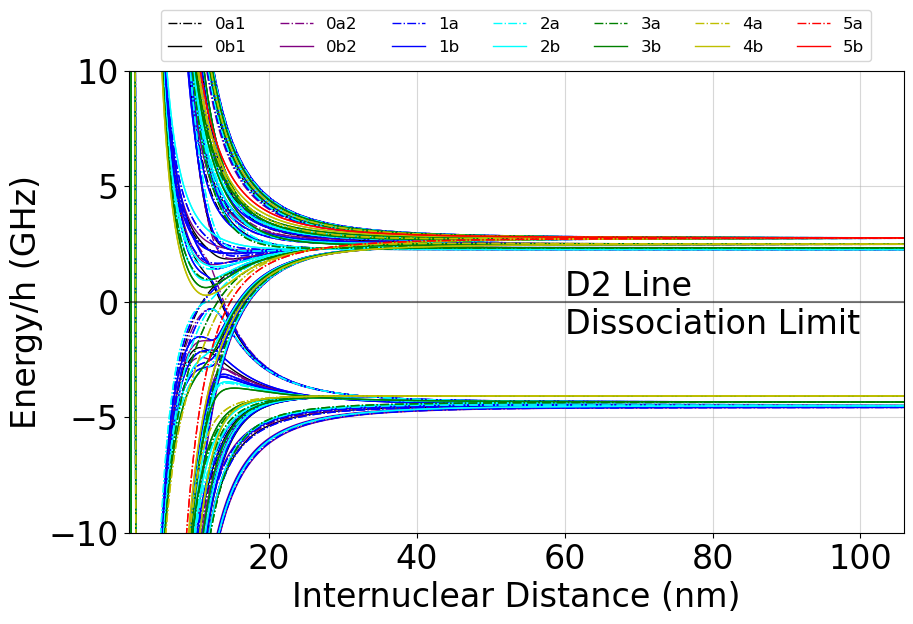

In [67]:
fig, ax = plt.subplots(figsize=(10,6))
fs = 24

fig.subplots_adjust(hspace=0.03, wspace=0.01)

titles = ["D2 Line",  
          r"D2 $f=1$",     r"D2 $f=2$",
          "D1 Line",  
          r"D1 $f=1$",     r"D1 $f=2$"]
allYlims = [(-10,10), 
            (-1,1),    (-1,1),
            (-10,10), 
            (-1,1),    (-1,1)]
yoffsets = np.array(
            [0,
            -mc.Rb87_Ground_ToF1,    -mc.Rb87_Ground_ToF2,
            E_FS_5P12_5P32/mc.h,
            E_FS_5P12_5P32/mc.h-mc.Rb87_Ground_ToF1,E_FS_5P12_5P32/mc.h-mc.Rb87_Ground_ToF2])/1e9
inc=1
labels = ['0a1','0b1','0a2','0b2','1a','1b','2a','2b','3a','3b','4a','4b','5a','5b']
#for num, (ax, title, ylims, yoff) in enumerate(zip(axs, titles, allYlims, yoffsets)):
which = 0
title, ylims, yoff = titles[which], allYlims[which], yoffsets[which]
for label in labels:
    color, linestyle = getLabelColorAndLinestyle(label)
    for datanum, mdata in enumerate(misc.transpose(energies[label])[::inc]):
        ax.plot(Rvals*1e9, np.array(mdata) * 1e-9 / mc.h + yoff , color=color, linestyle=linestyle, linewidth=1, 
                label=label if datanum==0 else None)
leg = ax.legend(fontsize=12, ncol=7, loc='upper center', bbox_to_anchor=(0.5,1.15))
for text in leg.get_texts():
    text.set_color("k")

ax.tick_params(axis='both', which='major', labelsize=fs)

ax.axhline(0,color='k',alpha=0.5)
ax.text(60,-1.4, title + "\nDissociation Limit", fontsize=fs, color='k')
ax.set_ylim(*ylims)
ax.set_xlim(min(Rvals)*1e9,max(Rvals)*1e9)
ax.grid(alpha=0.5)
#if num != len(axs)-1 and num != len(axs)-2 and num != 0:
#    ax.set_xticklabels([]);
#elif num != 0:
ax.set_xlabel('Internuclear Distance (nm)', fontsize=fs)
ax.set_ylabel('Energy/h (GHz)', fontsize=fs)
#plt.savefig("D1_Zoomed_Out.svg", dpi=100, transparent=True, bbox_inches='tight', pad_inches=0)

### Paper Zoomed Out

In [68]:
mpl.rcParams['figure.dpi']=300
mpl.rcParams['font.size']=8
mpl.rcParams['text.usetex']=True

<ipython-input-69-4736737ab288>:68: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  fig.text(0.05, 0.5, 'Energy (GHz)', rotation=90, verticalAlignment='center')
<ipython-input-69-4736737ab288>:69: MatplotlibDeprecationWarning: Case-insensitive properties were deprecated in 3.3 and support will be removed two minor releases later
  fig.text(0.5, 0.0, 'Internuclear Separation (nm)', rotation=0, horizontalAlignment='center')


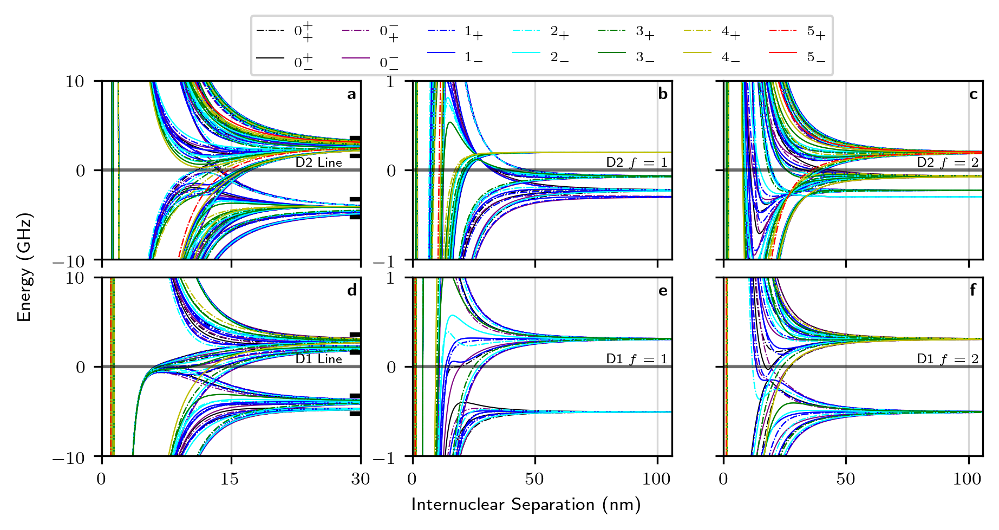

In [69]:

fig = plt.figure(figsize=(7,3))
gs = fig.add_gridspec(2,3)
axs = []
axs.append(fig.add_subplot(gs[0, 0]))
axs.append(fig.add_subplot(gs[0, 1]))
axs.append(fig.add_subplot(gs[0, 2]))
axs.append(fig.add_subplot(gs[1, 0]))
axs.append(fig.add_subplot(gs[1, 1]))
axs.append(fig.add_subplot(gs[1, 2]))

fig.subplots_adjust(hspace=0.03, wspace=0.01)

letterlabels = ['a','b','c','d','e','f']
titles = ["D2 Line",  
          r"D2 $f=1$",     r"D2 $f=2$",
          "D1 Line",  
          r"D1 $f=1$",     r"D1 $f=2$"]
allYlims = [(-10,10), 
            (-1,1),    (-1,1),
            (-10,10), 
            (-1,1),    (-1,1)]
yoffsets = np.array(
            [0,
            -mc.Rb87_Ground_ToF1,    -mc.Rb87_Ground_ToF2,
            E_FS_5P12_5P32/mc.h,
            E_FS_5P12_5P32/mc.h-mc.Rb87_Ground_ToF1,   E_FS_5P12_5P32/mc.h-mc.Rb87_Ground_ToF2])/1e9
inc=1
labels = ['0a1','0b1','0a2','0b2','1a','1b','2a','2b','3a','3b','4a','4b','5a','5b']
leglabels = ['0^+_+','0^{+}_{-}','0^-_+','0^-_{-}','1_+','1_-','2_+','2_-','3_+','3_-','4_+','4_-','5_+','5_-']
for num, (ax, title, ylims, yoff) in enumerate(zip(axs, titles, allYlims, yoffsets)):
    for labeln, label in enumerate(labels):
        color, linestyle = getLabelColorAndLinestyle(label)
        for datanum, mdata in enumerate(misc.transpose(energies[label])[::inc]):
            ax.plot(Rvals*1e9, np.array(mdata) * 1e-9 / mc.h + yoff , color=color, linestyle=linestyle, linewidth=0.5, 
                    label='$'+leglabels[labeln]+'$' if datanum==0 else None)
    ax.axhline(0,color='k',alpha=0.5)
    ax.text(0.75,0.52, title, fontsize=6, color='k', transform=ax.transAxes)
    ax.set_ylim(*ylims)
    if num in [0, 3]:
        ax.set_xlim(0,30)
        ax.set_xticks([0,15,30])
    else:
        ax.set_xlim(min(Rvals)*1e9,max(Rvals)*1e9)
        ax.set_xticks([0,50,100])
    ax.grid(alpha=0.5)
    if num in [1,2,4,5]:
        ax.set_yticks([-1,0,1])
        if num in [2,5]:
            ax.set_yticklabels([])
    elif num in [0,3]:
        ax.set_yticks([-10,0,10])
    else:
        ax.set_yticks([])
    #
    if num in [0,1,2]:
        ax.set_xticklabels([]);
    elif num != 0:
        #ax.set_xlabel('Internuclear Distance (nm)', fontsize=8)
        pass
    ax.text(0.95,0.9,r'$\textbf{'+letterlabels[num]+r'}$',transform=ax.transAxes)

leg = axs[1].legend(fontsize=6, ncol=7, loc='upper center', bbox_to_anchor=(0.5,1.4))
for text in leg.get_texts():
    text.set_color("k")

fig.subplots_adjust(wspace=0.2, hspace=0.1)

fig.text(0.05, 0.5, 'Energy (GHz)', rotation=90, verticalAlignment='center')
fig.text(0.5, 0.0, 'Internuclear Separation (nm)', rotation=0, horizontalAlignment='center')


yo = -yoffsets[1]
axs[0].plot([29,30],[yo+1,yo+1], lw=2,color='k')
axs[0].plot([29,30],[yo-1,yo-1], lw=2,color='k')
yo = -yoffsets[2]
axs[0].plot([29,30],[yo+1,yo+1], lw=2,color='k')
axs[0].plot([29,30],[yo-1,yo-1], lw=2,color='k')


yo = yoffsets[3]-yoffsets[4]
axs[3].plot([29,30],[yo+1,yo+1], lw=2,color='k')
axs[3].plot([29,30],[yo-1,yo-1], lw=2,color='k')
yo = yoffsets[3]-yoffsets[5]
axs[3].plot([29,30],[yo+1,yo+1], lw=2,color='k')
axs[3].plot([29,30],[yo-1,yo-1], lw=2,color='k')

plt.savefig("Hyperfine_Zoomed_Out.svg", dpi=100, transparent=True, bbox_inches='tight', pad_inches=0)

#### Zoomed out D1 & D2

In [70]:
fig = plt.figure(figsize=(30,60))
gs = fig.add_gridspec(6,2)
axs = []
axs.append(fig.add_subplot(gs[0, :]))
axs.append(fig.add_subplot(gs[1, 0]))
axs.append(fig.add_subplot(gs[1, 1]))
axs.append(fig.add_subplot(gs[2, :]))
axs.append(fig.add_subplot(gs[3, 0]))
axs.append(fig.add_subplot(gs[3, 1]))

fig.subplots_adjust(hspace=0.03, wspace=0.01)

titles = ["D2 Line",  
          r"D2 $f=1$",     r"D2 $f=2$",
          "D1 Line",  
          r"D1 $f=1$",     r"D1 $f=2$"]
allYlims = [(-10,10), 
            (-1,1),    (-1,1),
            (-10,10), 
            (-1,1),    (-1,1)]
yoffsets = np.array(
            [0,
            -mc.Rb87_Ground_ToF1,    -mc.Rb87_Ground_ToF2,
            E_FS_5P12_5P32/mc.h,
            E_FS_5P12_5P32/mc.h-mc.Rb87_Ground_ToF1,E_FS_5P12_5P32/mc.h-mc.Rb87_Ground_ToF2])/1e9
inc=1
labels = ['0a1','0b1','0a2','0b2','1a','1b','2a','2b','3a','3b','4a','4b','5a','5b']
for num, (ax, title, ylims, yoff) in enumerate(zip(axs, titles, allYlims, yoffsets)):
    for label in labels:
        color, linestyle = getLabelColorAndLinestyle(label)
        for datanum, mdata in enumerate(misc.transpose(energies[label])[::inc]):
            ax.plot(Rvals*1e9, np.array(mdata) * 1e-9 / mc.h + yoff , color=color, linestyle=linestyle, linewidth=1, 
                    label=label if datanum==0 else None)
    if num == 0:
        leg = ax.legend(fontsize=18, ncol=7, loc='upper center', bbox_to_anchor=(0.5,1.15))
        for text in leg.get_texts():
            text.set_color("k")
    ax.axhline(0,color='k',alpha=0.5)
    ax.text(80,0.01, title + "\nDissociation Limit", fontsize=20, color='k')
    ax.set_ylim(*ylims)
    ax.set_xlim(min(Rvals)*1e9,max(Rvals)*1e9)
    ax.grid(alpha=0.5)
    if num != len(axs)-1 and num != len(axs)-2 and num != 0:
        ax.set_xticklabels([]);
    elif num != 0:
        ax.set_xlabel('Internuclear Distance (nm)', fontsize=16)
    if num not in [0,1, 3,4]:
        ax.set_yticklabels([])
    else:
        ax.set_ylabel('Energy (GHz)', fontsize=16)
#plt.savefig("Symmetrized_Hyperfine_Splitting_Big_Picture.svg", dpi=100, transparent=True, bbox_inches='tight', pad_inches=0)

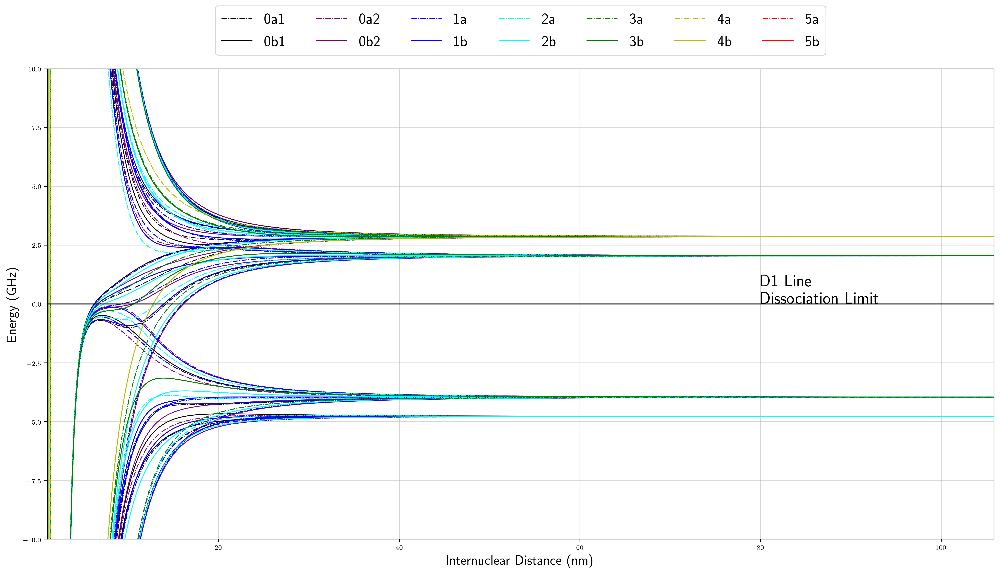

In [71]:
fig = plt.figure(figsize=(20,10))
axs = []
axs.append(fig.add_subplot())

fig.subplots_adjust(hspace=0.03, wspace=0.01)

titles = ["D2 Line",  
          r"D2 $f=1$",     r"D2 $f=2$",
          "D1 Line",  
          r"D1 $f=1$",     r"D1 $f=2$"]
allYlims = [(-10,10), 
            (-1,1),    (-1,1),
            (-10,10), 
            (-1,1),    (-1,1)]
yoffsets = np.array(
            [0,
            -mc.Rb87_Ground_ToF1,    -mc.Rb87_Ground_ToF2,
            E_FS_5P12_5P32/mc.h,
            E_FS_5P12_5P32/mc.h-mc.Rb87_Ground_ToF1,E_FS_5P12_5P32/mc.h-mc.Rb87_Ground_ToF2])/1e9
inc=1
labels = ['0a1','0b1','0a2','0b2','1a','1b','2a','2b','3a','3b','4a','4b','5a','5b']
which = 3
num = 0
(ax, title, ylims, yoff) = axs[0], titles[which], allYlims[which], yoffsets[which]
for label in labels:
    color, linestyle = getLabelColorAndLinestyle(label)
    for datanum, mdata in enumerate(misc.transpose(energies[label])[::inc]):
        ax.plot(Rvals*1e9, np.array(mdata) * 1e-9 / mc.h + yoff , color=color, linestyle=linestyle, linewidth=1, 
                label=label if datanum==0 else None)
if num == 0:
    leg = ax.legend(fontsize=18, ncol=7, loc='upper center', bbox_to_anchor=(0.5,1.15),facecolor='#FFFFFF00')
    for text in leg.get_texts():
        text.set_color("k")
ax.axhline(0,color='k',alpha=0.5)
ax.text(80,0.01, title + "\nDissociation Limit", fontsize=20, color='k')
ax.set_ylim(*ylims)
ax.set_xlim(min(Rvals)*1e9,max(Rvals)*1e9)
ax.grid(alpha=0.5)
if num != len(axs)-1 and num != len(axs)-2 and num != 0:
    ax.set_xticklabels([]);
elif num == 0:
    ax.set_xlabel('Internuclear Distance (nm)', fontsize=16)
if num not in [0,1, 3,4]:
    ax.set_yticklabels([])
else:
    ax.set_ylabel('Energy (GHz)', fontsize=16)
#plt.savefig("Single_D1.png", dpi=100, transparent=True, bbox_inches='tight', pad_inches=0)

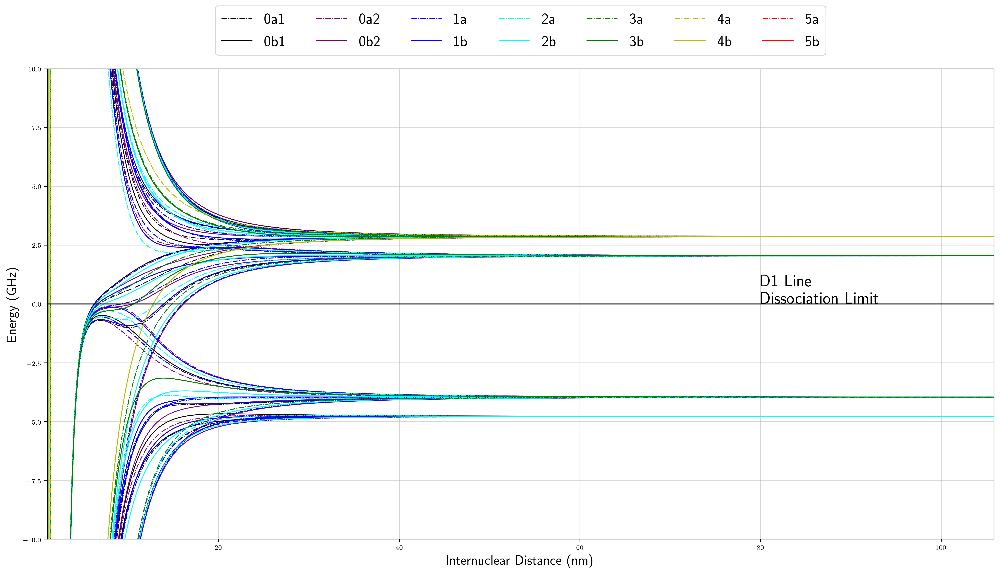

In [72]:
fig = plt.figure(figsize=(20,10))
axs = []
axs.append(fig.add_subplot())

fig.subplots_adjust(hspace=0.03, wspace=0.01)

titles = ["D2 Line",  
          r"D2 $f=1$",     r"D2 $f=2$",
          "D1 Line",  
          r"D1 $f=1$",     r"D1 $f=2$"]
allYlims = [(-10,10), 
            (-1,1),    (-1,1),
            (-10,10), 
            (-1,1),    (-1,1)]
yoffsets = np.array(
            [0,
            -mc.Rb87_Ground_ToF1,    -mc.Rb87_Ground_ToF2,
            E_FS_5P12_5P32/mc.h,
            E_FS_5P12_5P32/mc.h-mc.Rb87_Ground_ToF1,E_FS_5P12_5P32/mc.h-mc.Rb87_Ground_ToF2])/1e9
inc=1
labels = ['0a1','0b1','0a2','0b2','1a','1b','2a','2b','3a','3b','4a','4b','5a','5b']
which = 3
num = 0
(ax, title, ylims, yoff) = axs[0], titles[which], allYlims[which], yoffsets[which]
for label in labels:
    color, linestyle = getLabelColorAndLinestyle(label)
    for datanum, mdata in enumerate(misc.transpose(energies[label])[::inc]):
        ax.plot(Rvals*1e9, np.array(mdata) * 1e-9 / mc.h + yoff , color=color, linestyle=linestyle, linewidth=1, 
                label=label if datanum==0 else None)
if num == 0:
    leg = ax.legend(fontsize=18, ncol=7, loc='upper center', bbox_to_anchor=(0.5,1.15),facecolor='#FFFFFF00')
    for text in leg.get_texts():
        text.set_color("k")
ax.axhline(0,color='k',alpha=0.5)
ax.text(80,0.01, title + "\nDissociation Limit", fontsize=20, color='k')
ax.set_ylim(*ylims)
ax.set_xlim(min(Rvals)*1e9,max(Rvals)*1e9)
ax.grid(alpha=0.5)
if num != len(axs)-1 and num != len(axs)-2 and num != 0:
    ax.set_xticklabels([]);
elif num == 0:
    ax.set_xlabel('Internuclear Distance (nm)', fontsize=16)
if num not in [0,1, 3,4]:
    ax.set_yticklabels([])
else:
    ax.set_ylabel('Energy (GHz)', fontsize=16)
#plt.savefig("Single_D1.png", dpi=100, transparent=True, bbox_inches='tight', pad_inches=0)

#### D2 Zoomed In

In [73]:
19*4+34*2+24*2+13*2+5*2+2

230

In [74]:
fig = plt.figure(figsize=(30,35))
gs = fig.add_gridspec(4,2)
fs = 24
axs = []
for i1, i2 in zip([0,0,1,1,2,2,3,3], [0,1,0,1,0,1,0,1]):
    axs.append(fig.add_subplot(gs[i1,i2]))
fig.subplots_adjust(hspace=0.03, wspace=0.01)

titles = [r"D2 $f=1,f'=3$",r"D2 $f=2,f'=3$",
          r"D2 $f=1,f'=2$",r"D2 $f=2,f'=2$",
          r"D2 $f=1,f'=1$",r"D2 $f=2,f'=1$",
          r"D2 $f=1,f'=0$",r"D2 $f=2,f'=0$"]

allYlims = [(-0.1,0.1), (-0.1,0.1),
            (-0.1,0.1), (-0.1,0.1),
            (-0.1,0.1), (-0.1,0.1),
            (-0.1,0.1), (-0.1,0.1),]
yoffsets = np.array(
            [-mc.Rb87_Ground_ToF1-mc.Rb87_5P32_ToF3,-mc.Rb87_Ground_ToF2-mc.Rb87_5P32_ToF3,
             -mc.Rb87_Ground_ToF1-mc.Rb87_5P32_ToF2,-mc.Rb87_Ground_ToF2-mc.Rb87_5P32_ToF2,
             -mc.Rb87_Ground_ToF1-mc.Rb87_5P32_ToF1,-mc.Rb87_Ground_ToF2-mc.Rb87_5P32_ToF1,
             -mc.Rb87_Ground_ToF1-mc.Rb87_5P32_ToF0,-mc.Rb87_Ground_ToF2-mc.Rb87_5P32_ToF0])/1e9

inc=1
for num, (ax, title, ylims, yoff) in enumerate(zip(axs[:], titles, allYlims, yoffsets)):
    for label in labels:
        color, linestyle = getLabelColorAndLinestyle(label)
        numStatesStr = " ("+ str(len(allBases[label])) + ")" if label[0] == '0' else " ("+ str(int(len(allBases[label])/2)) + ")"
        for datanum, mdata in enumerate(misc.transpose(energies[label])[::inc]):
            ax.plot(Rvals*1e9, np.array(mdata) * 1e-9 / mc.h + yoff , color=color, linestyle=linestyle, linewidth=1, 
                    label=label + numStatesStr if datanum==0 else None)
    if num == 0:
        leg = ax.legend(fontsize=18, ncol=7, loc='upper center', bbox_to_anchor=(1,1.15))
        for text in leg.get_texts():
            text.set_color("k")
    ax.axhline(0,color='k',alpha=0.5, linewidth=2)
    ax.text(80,0.01, title + "\nDissociation Limit", fontsize=20, color='k')
    ax.set_ylim(*ylims)
    ax.set_xlim(min(Rvals)*1e9,max(Rvals)*1e9)
    ax.grid(alpha=0.5)
    if num != len(axs)-1 and num != len(axs)-2:
        ax.set_xticklabels([]);
    elif num != 0:
        ax.set_xlabel('Internuclear Distance (nm)', fontsize=fs)
    if num % 2 == 1:
        ax.set_yticklabels([])
    else:
        ax.set_ylabel('Energy (GHz)', fontsize=fs)
    ax.tick_params(axis='both', which='major', labelsize=fs)
#plt.savefig("Symmetrized_Hyperfine_Splitting_D2_Zoom.png", dpi=100, transparent=True, bbox_inches='tight', pad_inches=0)

## Plotly Plotting

import plotly.offline as ploff
import numpy as np

import plotly.graph_objs as go
from plotly.offline import iplot, plot as plotlyplot
import plotly.subplots as ply_subplots
from plotly.tools import make_subplots

ploff.init_notebook_mode(connected=False)

data = []
for label in labels:
    color, linestyle = getLabelColorAndLinestyle(label)
    for datanum, mdata in enumerate(misc.transpose(energies[label])[::inc]):
        data.append(go.Scatter(x=Rvals*1e9, y=np.array(mdata) * 1e-9 / mc.h + yoff))

def getLabelColorAndLinestyle(label):
    phiColors=['purple','blue','green', 'orange','red', '#FF69B4']       
    if label[0] == '0':
        if label[-1] == '1':
            color = 'black'
        elif label[-1] == '2':
            color = '#800080'
    else:
        color = phiColors[int(label[0])]
    linestyle = 'dash' if label[1] == 'b' else 'solid'
    return color, linestyle

### Plotly Zoomed Out

titles = ["D2 Line",  
          "D2 f=1",     "D2 f=2",
          "D1 Line",  
          "D1 f=1",     "D1 f=2"]
allYlims = [(-10,10), 
            (-1,1),    (-1,1),
            (-10,10), 
            (-1,1),    (-1,1)]
yoffsets = np.array(
            [0,
            -mc.Rb87_Ground_ToF1,-mc.Rb87_Ground_ToF2,
            E_FS_5P12_5P32/mc.h,
            E_FS_5P12_5P32/mc.h-mc.Rb87_Ground_ToF1,E_FS_5P12_5P32/mc.h-mc.Rb87_Ground_ToF2])/1e9
n = None
r = 'rowspan'
c = 'colspan'
fig = ply_subplots.make_subplots(rows=4, cols=2, print_grid=False, horizontal_spacing=0.01, vertical_spacing=0.01,
    specs=[[{r: 1, c: 2}, n],
           [{r: 1, c: 1}, {r: 1, c: 1}],
           [{r: 1, c: 2}, n],
           [{r: 1, c: 1}, {r: 1, c: 1}]])
fig.update_layout(
    autosize=False,
    width=1000,
    height=1500,
    paper_bgcolor='white',
    plot_bgcolor='white', legend=dict(font={'size':8}, yanchor="bottom", y=1.005, xanchor="right", x=1), legend_orientation="h")
inc=1

axCoord = [[1,1],[2,1],[2,2],[3,1],[4,1],[4,2]]
labels = ['0a1','0b1','0a2','0b2','1a','1b','2a','2b','3a','3b','4a','4b','5a','5b']
for num, (ax, title, ylims, yoff) in enumerate(zip(axCoord, titles, allYlims, yoffsets)):
    for label in labels[:]:
        color, linestyle = getLabelColorAndLinestyle(label)
        for datanum, mdata in enumerate(misc.transpose(energies[label])[::inc]):
            fig.add_trace(
                go.Scatter(x=Rvals*1e9, y=np.array(mdata) * 1e-9 / mc.h + yoff, 
                           mode='lines', name=label, line={'color': color, 'width': 1, 'dash':linestyle},
                           legendgroup=label, showlegend=True if datanum==0 and num==0 else False), 
                          ax[0],ax[1])
    fig['layout']['yaxis'+str(num+1)].update(range=ylims)
    fig['layout']['xaxis'+str(num+1)].update(range=[min(Rvals)*1e9,max(Rvals)*1e9])
    fig.add_trace(go.Scatter( x=[80], y=[0], mode="text", text=[title + "\nDissociation Limit"],
                  textposition="top center",showlegend=False),row=ax[0],col=ax[1])
    fig.add_shape(type='line',x0=0,y0=0,x1=1,y1=0,
                  line=dict(color='Red',), xref='x', row=ax[0],col=ax[1])
    if num in [4,5]:
        fig.update_xaxes(title_text='Internuclear Distance (nm)', row=ax[0],col=ax[1])
    if num in [1,2,3]:
        fig.update_xaxes(showticklabels=False, row=ax[0],col=ax[1])
    if num not in [0, 1, 3, 4]:
        fig.update_yaxes(showticklabels=False, row=ax[0],col=ax[1])
    else:
        fig.update_yaxes(title_text='Energy (GHz)', row=ax[0], col=ax[1])
fig.update_xaxes(showgrid=True, gridwidth=1, gridcolor='rgba(200,200,200,50)',
                mirror=True, showline=True, linecolor='black',
                zeroline=True, zerolinecolor='black')
fig.update_yaxes(showgrid=True, gridwidth=1, gridcolor='rgba(200,200,200,50)',
                mirror=True,showline=True, linecolor='black',
                zeroline=True, zerolinecolor='black')
fig.write_html("Zoomed_Out.html")
fig.show()

### Plotly D2 Zoomed In

fig = ply_subplots.make_subplots(rows=4, cols=2, print_grid=False, horizontal_spacing=0.01, vertical_spacing=0.01,
    specs=[[{r: 1, c: 1}, {r: 1, c: 1}],
           [{r: 1, c: 1}, {r: 1, c: 1}],
           [{r: 1, c: 1}, {r: 1, c: 1}],
           [{r: 1, c: 1}, {r: 1, c: 1}]])
titles = [
          r"D2 f=1,f'=3",r"D2 f=2,f'=3",
          r"D2 f=1,f'=2",r"D2 f=2,f'=2",
          r"D2 f=1,f'=1",r"D2 f=2,f'=1",
          r"D2 f=1,f'=0",r"D2 f=2,f'=0"]
allYlims = [
            (-0.1,0.1), (-0.1,0.1),
            (-0.1,0.1), (-0.1,0.1),
            (-0.1,0.1), (-0.1,0.1),
            (-0.1,0.1), (-0.1,0.1),]
yoffsets = np.array(
            [-mc.Rb87_Ground_ToF1-mc.Rb87_5P32_ToF3,-mc.Rb87_Ground_ToF2-mc.Rb87_5P32_ToF3,
             -mc.Rb87_Ground_ToF1-mc.Rb87_5P32_ToF2,-mc.Rb87_Ground_ToF2-mc.Rb87_5P32_ToF2,
             -mc.Rb87_Ground_ToF1-mc.Rb87_5P32_ToF1,-mc.Rb87_Ground_ToF2-mc.Rb87_5P32_ToF1,
             -mc.Rb87_Ground_ToF1-mc.Rb87_5P32_ToF0,-mc.Rb87_Ground_ToF2-mc.Rb87_5P32_ToF0])/1e9
axCoord = [[1,1],[1,2],[2,1],[2,2],[3,1],[3,2],[4,1],[4,2]]
fig.update_layout(
    autosize=False,
    width=1000,
    height=1500,
    paper_bgcolor='white',
    plot_bgcolor='white', legend=dict(font={'size':8}, yanchor="bottom", y=1.005, xanchor="right", x=1), legend_orientation="h")
inc=1
for num, (ax, title, ylims, yoff) in enumerate(zip(axCoord, titles, allYlims, yoffsets)):
    for label in labels[:]:
        color, linestyle = getLabelColorAndLinestyle(label)
        for datanum, mdata in enumerate(misc.transpose(energies[label])[::inc]):
            fig.add_trace(
                go.Scatter(x=Rvals*1e9, y=np.array(mdata) * 1e-9 / mc.h + yoff, 
                           mode='lines', name=label, line={'color': color, 'width': 1, 'dash':linestyle},
                           legendgroup=label, showlegend=True if datanum==0 and num==0 else False), 
                           ax[0],ax[1])
    fig['layout']['yaxis'+str(num+1)].update(range=ylims)
    fig['layout']['xaxis'+str(num+1)].update(range=[min(Rvals)*1e9,max(Rvals)*1e9])
    fig.add_trace(go.Scatter( x=[80], y=[0], mode="text", text=[title + "\nDissociation Limit"],
                  textposition="top center",showlegend=False),row=ax[0],col=ax[1])
    fig.add_shape(type='line',x0=0,y0=0,x1=1,y1=0,
                  line=dict(color='Red',), xref='x', row=ax[0],col=ax[1])
    if num in [6,7]:
        fig.update_xaxes(title_text='Internuclear Distance (nm)', row=ax[0],col=ax[1])
    else:
        fig.update_xaxes(showticklabels=False, row=ax[0],col=ax[1])
    if num not in [0, 2, 4, 6]:
        fig.update_yaxes(showticklabels=False, row=ax[0],col=ax[1])
    else:
        fig.update_yaxes(title_text='Energy (GHz)', row=ax[0], col=ax[1])
fig.update_xaxes(showgrid=True, gridwidth=1, gridcolor='rgba(200,200,200,50)',
                mirror=True, showline=True, linecolor='black',
                zeroline=True, zerolinecolor='black')
fig.update_yaxes(showgrid=True, gridwidth=1, gridcolor='rgba(200,200,200,50)',
                mirror=True,showline=True, linecolor='black',
                zeroline=True, zerolinecolor='black')
fig.write_html("D2_Zoom.html")
fig.show()

### Plotly D1 Zoomed In

titles = [r"D1 f=1,f'=2",r"D1 f=2,f'=2",
          r"D1 f=1,f'=1",r"D1 f=2,f'=1"]
fig = ply_subplots.make_subplots(rows=2, cols=2, print_grid=False, horizontal_spacing=0.01, vertical_spacing=0.01,
    specs=[[{r: 1, c: 1}, {r: 1, c: 1}],
           [{r: 1, c: 1}, {r: 1, c: 1}]])
allYlims = np.array(
           [(-0.3,0.3),  (-0.3,0.3),
            (-0.3,0.3),  (-0.3,0.3)])
yoffsets = np.array(         
            [-mc.Rb87_Ground_ToF1-mc.Rb87_5P12_ToF2,-mc.Rb87_Ground_ToF2-mc.Rb87_5P12_ToF2,
             -mc.Rb87_Ground_ToF1-mc.Rb87_5P12_ToF1,-mc.Rb87_Ground_ToF2-mc.Rb87_5P12_ToF1])/1e9
yoffsets += E_FS_5P12_5P32/mc.h/1e9
axCoord = [[1,1],[1,2],[2,1],[2,2],[3,1],[3,2]]
fig.update_layout(
    autosize=False, width=1000, height=750, paper_bgcolor='white', plot_bgcolor='white', 
    legend=dict(font={'size':8}, yanchor="bottom", y=1.005, xanchor="right", x=1), legend_orientation="h")
inc=1
for num, (ax, title, ylims, yoff) in enumerate(zip(axCoord, titles, allYlims, yoffsets)):
    for label in labels[:]:
        color, linestyle = getLabelColorAndLinestyle(label)
        for datanum, mdata in enumerate(misc.transpose(energies[label])[::inc]):
            fig.add_trace(
                go.Scatter(x=Rvals*1e9, y=np.array(mdata) * 1e-9 / mc.h + yoff, 
                           mode='lines', name=label, line={'color': color, 'width': 1, 'dash':linestyle},
                           legendgroup=label, showlegend=True if datanum==0 and num==0 else False), 
                          ax[0],ax[1])
    fig['layout']['yaxis'+str(num+1)].update(range=ylims)
    fig['layout']['xaxis'+str(num+1)].update(range=[min(Rvals)*1e9,max(Rvals)*1e9])
    fig.add_trace(go.Scatter( x=[80], y=[0.05], mode="text", text=[title + "\nDissociation Limit"],
                  textposition="top center",showlegend=False),row=ax[0],col=ax[1])
    fig.add_shape(type='line',x0=0,y0=0,x1=1,y1=0,
                  line=dict(color='Red',), xref='x', row=ax[0],col=ax[1])
    if num in [4,5]:
        fig.update_xaxes(title_text='Internuclear Distance (nm)', row=ax[0],col=ax[1])
    else:
        fig.update_xaxes(showticklabels=False, row=ax[0],col=ax[1])
    if num not in [0, 2, 4, 6]:
        fig.update_yaxes(showticklabels=False, row=ax[0],col=ax[1])
    else:
        fig.update_yaxes(title_text='Energy (GHz)', row=ax[0], col=ax[1])
fig.update_xaxes(showgrid=True, gridwidth=1, gridcolor='rgba(200,200,200,50)',
                mirror=True, showline=True, linecolor='black',
                zeroline=True, zerolinecolor='black')
fig.update_yaxes(showgrid=True, gridwidth=1, gridcolor='rgba(200,200,200,50)',
                mirror=True,showline=True, linecolor='black',
                zeroline=True, zerolinecolor='black')
fig.write_html("D1_Zoom.html")
fig.show()

V = 100e3
U = A * V**(3/2)
print(U)